<a href="https://colab.research.google.com/github/MarcusBarao/GEOPANDAS/blob/main/Tratamento_de_dados_geospeciais.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Pratica do exercicio realizado em video https://www.youtube.com/watch?v=pOn0cQBsvxM e plot com folium


1. Istalar as biblotecas que serao utilizadas e preparar montar o google drive.

In [ ]:
!pip install geopandas
!pip install folium matplotlib mapclassify

In [ ]:
from google.colab import drive
drive.mount('/content/drive/MyDrive')

In [ ]:
%cd /content/drive/MyDrive/COLAB/IBGE

2. Download dos dados

In [ ]:
!wget -P /content/drive/MyDrive/COLAB/IBGE https://geoftp.ibge.gov.br/cartas_e_mapas/bases_cartograficas_continuas/bc250/versao2023/geopackage/bc250_2023_11_23.zip

--2024-04-05 09:22:52--  https://geoftp.ibge.gov.br/cartas_e_mapas/bases_cartograficas_continuas/bc250/versao2023/geopackage/bc250_2023_11_23.zip
Resolving geoftp.ibge.gov.br (geoftp.ibge.gov.br)... 191.233.136.86
Connecting to geoftp.ibge.gov.br (geoftp.ibge.gov.br)|191.233.136.86|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 873513723 (833M) [application/zip]
Saving to: ‘/content/drive/MyDrive/COLAB/IBGE/bc250_2023_11_23.zip’

bc250_2023_11_23.zi 100%[===================>] 833.05M  19.2MB/s    in 47s     

2024-04-05 09:23:40 (17.7 MB/s) - ‘/content/drive/MyDrive/COLAB/IBGE/bc250_2023_11_23.zip’ saved [873513723/873513723]



In [ ]:
!unzip /content/drive/MyDrive/COLAB/IBGE/bc250_2023_11_23.zip -d /content/drive/MyDrive/COLAB/IBGE

Archive:  /content/drive/MyDrive/COLAB/IBGE/bc250_2023_11_23.zip
replace /content/drive/MyDrive/COLAB/IBGE/bc250_2023_11_23.gpkg? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [ ]:
import geopandas as gpd
import matplotlib as plt

In [ ]:
ibge_gpkg ='/content/drive/MyDrive/COLAB/IBGE/bc250_2023_11_23.gpkg'

In [ ]:
mun_br=gpd.read_file(ibge_gpkg, layer='lml_municipio_a')

In [ ]:
mun_br

,nome,geometriaaproximada,geocodigo,anodereferencia,geometry
0,Acajutiba,Não,2900306,None,"MULTIPOLYGON (((-38.08154 -11.61072, -38.08087..."
1,Aporá,Não,2901908,None,"MULTIPOLYGON (((-38.14169 -11.80348, -38.14440..."
2,Campestre do Maranhão,Não,2102556,None,"MULTIPOLYGON (((-47.04383 -6.19768, -47.04673 ..."
3,Porto Murtinho,Não,5006903,None,"MULTIPOLYGON (((-56.94176 -21.59373, -56.94243..."
4,Pimenteiras do Oeste,Não,1101468,None,"MULTIPOLYGON (((-60.91895 -13.54821, -60.91808..."
...,...,...,...,...,...
5565,Cruzeiro do Sul,Não,4106704,None,"MULTIPOLYGON (((-52.25933 -22.89856, -52.25897..."
5566,Paranavaí,Não,4118402,None,"MULTIPOLYGON (((-52.42102 -23.13957, -52.42126..."
5567,Alto Paraná,Não,4100608,None,"MULTIPOLYGON (((-52.37157 -22.92937, -52.36787..."
5568,Paranacity,Não,4118105,None,"MULTIPOLYGON (((-52.05846 -22.95390, -52.08287..."


<Axes: >

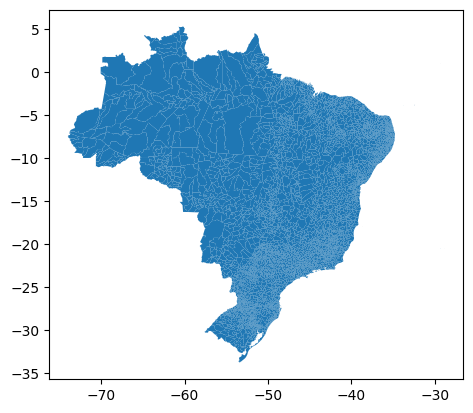

In [ ]:
mun_br.plot()

In [ ]:
estados = gpd.read_file(ibge_gpkg, layer='lml_unidade_federacao_a')
estados

,nome,geometriaaproximada,sigla,geocodigo,geometry
0,Alagoas,Não,AL,27,"MULTIPOLYGON (((-36.30191 -10.34226, -36.30001..."
1,Sergipe,Não,SE,28,"MULTIPOLYGON (((-37.63182 -11.52486, -37.63255..."
2,Rio Grande do Norte,Não,RN,24,"MULTIPOLYGON (((-33.81428 -3.87392, -33.81439 ..."
3,Paraíba,Não,PB,25,"MULTIPOLYGON (((-38.45711 -7.71814, -38.46400 ..."
4,Amazonas,Não,AM,13,"MULTIPOLYGON (((-58.14164 -7.34321, -58.13600 ..."
5,Amapá,Não,AP,16,"MULTIPOLYGON (((-50.82557 2.51865, -50.82604 2..."
6,Roraima,Não,RR,14,"MULTIPOLYGON (((-60.03829 0.26352, -60.03773 0..."
7,Rondônia,Não,RO,11,"MULTIPOLYGON (((-60.71040 -13.69079, -60.71169..."
8,Acre,Não,AC,12,"MULTIPOLYGON (((-68.38867 -11.04129, -68.38822..."
9,Espírito Santo,Não,ES,32,"MULTIPOLYGON (((-28.85365 -20.47547, -28.85372..."


<Axes: >

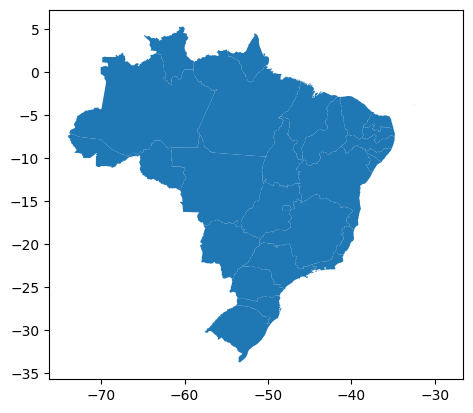

In [ ]:
estados.plot()

In [ ]:
for idx, row in estados.iterrows():
  query = mun_br['geocodigo'].str.startswith(row['geocodigo'])
  result = mun_br[query]
  result.to_file('/content/drive/MyDrive/COLAB/IBGE/municipios_br.gpkg', layer=f"{row['sigla'].lower()}", driver="GPKG")

/usr/local/lib/python3.10/dist-packages/geopandas/io/file.py:572: UserWarning: You are attempting to write an empty DataFrame to file. For some drivers, this operation may fail.
  _to_file_fiona(df, filename, driver, schema, crs, mode, **kwargs)
/usr/local/lib/python3.10/dist-packages/geopandas/io/file.py:572: UserWarning: You are attempting to write an empty DataFrame to file. For some drivers, this operation may fail.
  _to_file_fiona(df, filename, driver, schema, crs, mode, **kwargs)


In [ ]:
estados_mun_gpkg ='/content/drive/MyDrive/COLAB/IBGE/municipios_br.gpkg'
sc_mun = gpd.read_file(estados_mun_gpkg, layer='sc')
sc_mun

,nome,geometriaaproximada,geocodigo,anodereferencia,geometry
0,Campo Belo do Sul,Não,4203402,None,"MULTIPOLYGON (((-50.87454 -28.04087, -50.87706..."
1,Jaguaruna,Não,4208807,None,"MULTIPOLYGON (((-49.18787 -28.80416, -49.18787..."
2,Timbó,Não,4218202,None,"MULTIPOLYGON (((-49.20693 -26.83106, -49.23013..."
3,Bom Retiro,Não,4202602,None,"MULTIPOLYGON (((-49.30139 -27.90079, -49.31812..."
4,Tunápolis,Não,4218756,None,"MULTIPOLYGON (((-53.64627 -27.04810, -53.64702..."
...,...,...,...,...,...
290,Angelina,Não,4200903,None,"MULTIPOLYGON (((-48.92010 -27.46150, -48.92186..."
291,Nova Trento,Não,4211504,None,"MULTIPOLYGON (((-49.22273 -27.32271, -49.22563..."
292,Itapoá,Não,4208450,None,"MULTIPOLYGON (((-48.74235 -26.12851, -48.74534..."
293,Porto Belo,Não,4213500,None,"MULTIPOLYGON (((-48.57902 -27.21046, -48.57936..."


In [ ]:
estados.explore(
    column="nome",
    tooltip="nome",
    popup=True,
    tiles="CartoDB positron",
    cmap="Set1",
    style_kwds=dict(color="black"),
)

In [56]:
## Proxima etapa:calcular area de cada mapa e classicar por numeros de habitantes

##plotar duas vezes: primeiro Brasil
                    ##segundo santa catarina com a relacao de densidade area x populacao